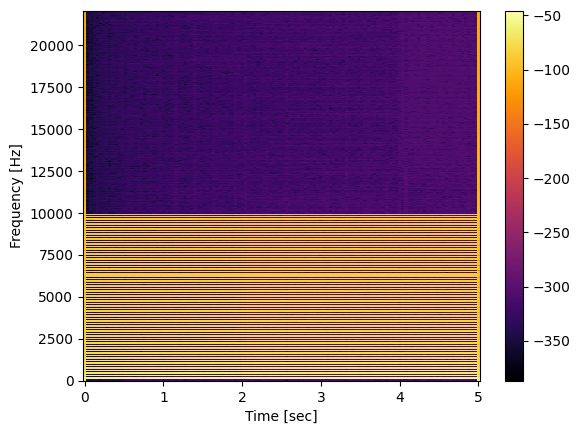

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from scipy import signal

# Generate a test signal
sample_rate = 44100  # Hz
duration = 5  # seconds
t = np.linspace(0, duration, sample_rate * duration, endpoint=False)
frequencies = np.arange(100, 10000, 100)  # Hz
amplitudes = 1 / frequencies
signal_data = np.zeros_like(t)
for freq, amp in zip(frequencies, amplitudes):
    signal_data += amp * np.sin(2 * np.pi * freq * t)

# Compute the spectrogram using the STFT function from scipy
nperseg = int(0.05 * sample_rate)  # Use 50 ms windows
noverlap = int(0.01 * sample_rate)  # Use 10 ms overlap
frequencies, times, spectrogram = signal.stft(signal_data, fs=sample_rate, nperseg=nperseg, noverlap=noverlap)

# Plot the spectrogram
plt.pcolormesh(times, frequencies, 20 * np.log10(np.abs(spectrogram)), cmap='inferno')
plt.ylabel('Frequency [Hz]')
plt.xlabel('Time [sec]')
plt.colorbar()
plt.show()


## Extract

In [3]:
import os
import zipfile
from pathlib import Path
import logging

f = "/home/roberto/PythonProjects/SSFocus/Data/RAW/SM/S1A_S1_RAW__0SSV_20200110T183210_20200110T183241_030742_038657_8CCA.zip"
with zipfile.ZipFile(f, 'r') as zip_ref:
    zip_ref.extractall("/home/roberto/PythonProjects/SSFocus/Data/RAW/SM/Extracted")

In [ ]:
import logging
import matplotlib.pyplot as plt
import cmath
import numpy as np
import math as math
import os, sys
import sentinel1decoder
import sentinel1decoder.constants
import sentinel1decoder.utilities
import logging
from scipy.interpolate import interp1d
import argparse
from pathlib import Path
import pandas as pd
import torch
from SARProcessor.focus import RD


input_file = "/home/roberto/PythonProjects/SSFocus/Data/RAW/SM/Extracted/S1A_S1_RAW__0SSV_20200110T183210_20200110T183241_030742_038657_8CCA.SAFE/s1a-s1-raw-s-vv-20200110t183210-20200110t183241-030742-038657.dat"
filename = Path(input_file).stem

# Create objects
decoder = sentinel1decoder.Level0Decoder(input_file, log_level=logging.WARNING)
raw_df = decoder.decode_metadata()
ephemeris = sentinel1decoder.utilities.read_subcommed_data(raw_df)



In [ ]:
# chunks the sub-swaths
focuser = RD(decoder=decoder, raw=raw_df, ephemeris=ephemeris)
img_focused = focuser.process()
parent_dir = Path(input_file).parent.parent

logger.info("Checking if the parent directory exists") # log statement
assert parent_dir.is_dir(), "The parent directory does not exist" # check if the parent directory is a directory
logger.info("The parent directory exists") # log statement
# create the directory if it does not exist
os.makedirs(args.output_folder, exist_ok=True)            
pd.to_pickle(img_focused, f"{args.output_folder}/{idx}_subswath.pkl")
logger.info("The sub-swath has been saved")